In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = ''
os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'

In [115]:
import zipfile
import os
import numpy as np

from PIL import Image
from typing import List, Optional
from PIL import ImageOps

class BaseImage:
    def __init__(self,folder: str, filenames: List[str]):
        self.folder = folder
        self.filenames = filenames
        self.existant = [os.path.isfile(f"{folder}/{f}") for f in filenames]
        
    def __getitem__(self, index):
        return Image.open(f"{self.folder}/{self.filenames[index]}")
    
    def __len__(self):
        return np.sum(self.existant)
    
class BasePredictor:
    pass
    
class Prediction(BasePredictor):
    def __init__(self,folder: str, filenames: List[str]):
        self.folder = folder
        self.filenames = filenames
        self.existant = [os.path.isfile(f"{folder}/{f}") for f in filenames]
        
    def __getitem__(self, index: int):
        return Image.open(f"{self.folder}/{self.filenames[index]}").convert('L')
    
    def __len__(self):
        return np.sum(self.existant)
    
    
class ZipPrediction(BasePredictor):
    def __init__(self, archive: str, filenames: List[str]):
        self.archive = zipfile.ZipFile(archive, 'r')
        self.filenames = filenames
            
    def __getitem__(self, index: int):
        filename = self.filenames[index]
        return Image.open(self.archive.open(filename)).convert('L')
    
class Ansambler:
    def __init__(self, predictors: List[BasePredictor], alphas=None, threshold = 128):
        self.predictors = predictors
        self.alphas = [1./len(predictors) for _ in predictors] if alphas is None else alphas
        self.threshold = threshold
        
    def __getitem__(self, index: int):
        arrays = []
        
        for i, pred in enumerate(self.predictors):
            arrays.append(np.asarray(pred[index], dtype=np.float32)*self.alphas[i])
            
        res = np.sum(np.array(arrays), axis=0)
        return Image.fromarray(np.clip(res, 0, 255).astype(np.uint8)).convert('L').point(lambda p: 255 if p > self.threshold else 0)
    
def get_prediction_explorer(folder: str, filenames: List[str]):
    if folder.endswith('.zip'):
        return ZipPrediction(folder, filenames)
    return Prediction(folder, filenames)
    
def draw_mask(image: Image.Image, mask: Image.Image,color=(255,0,0)):
    mode = 'RGBA' if len(color) == 4 else 'RGB'
    return Image.composite(image, Image.new(mode, image.size, color), ImageOps.invert(mask.convert('L')))

def ansamble_predictions(folders: List[str], filenames: List[str]):
    predictors = [get_prediction_explorer(fold, filenames) for fold in folders]
    
    
import matplotlib.pylab as plt

def plot_side_by_side(*args, figsize=(20,20)):
    fig, ax = plt.subplots(1, len(args), figsize=figsize)
    for i, a in enumerate(args):
        ax[i].axis('off')
        ax[i].imshow(a)
    
    plt.tight_layout()
    plt.show()
    
def view_resied(image: Image.Image, size=(320,320)):
    image.resize(size).show()

In [353]:
filenames = sorted(os.listdir('../datasets/0-last-clean-2/valid/images/'), key=lambda x: int(x.split('.')[0]))
bi = BaseImage('../datasets/0-last-clean-2/valid/images/', filenames)
bm = BaseImage('../datasets/0-last-clean-2/valid/masks/', filenames)
# pred = get_prediction_explorer('../experiments/unet/20220930-134218-resnet34-1024-1-1e-05-300-1-basic-1-basic/20220930-154002-submit-temp.zip', filenames)
pred2  = get_prediction_explorer('../experiments/unet/20220930-151914-resnet34-1024-1-0.0001-300-2-filtered-mini-2-filtered-mini/20220930-154403-submit-temp.zip', filenames)

# pred = get_prediction_explorer('../experiments/unet/20220930-134218-resnet34-1024-1-1e-05-300-1-basic-1-basic/20220930-154002-submit-temp.zip', filenames)
# pred2  = get_prediction_explorer('../experiments/unet/20220930-194709-resnet34-1024-4-0.0001-300-0-last-clean-small-0-last-clean-small/20220930-201652-submit-temp.zip', filenames)


# pred1  = get_prediction_explorer('../experiments/unet/1-3-before-resnet18-1024-12-1e-05-300-0-last-clean-2-0-last-clean-2/20220930-143713-submit-temp.zip', filenames)
# pred2  = get_prediction_explorer('../experiments/unet/20220930-151914-resnet34-1024-1-0.0001-300-2-filtered-mini-2-filtered-mini/20220930-152336-submit-temp.zip', filenames)
# pred3  = get_prediction_explorer('../experiments/unet/20220930-151353-resnet34-1024-1-0.0001-300-0-last-broken-0-last-broken/20220930-152648-submit-temp.zip', filenames)


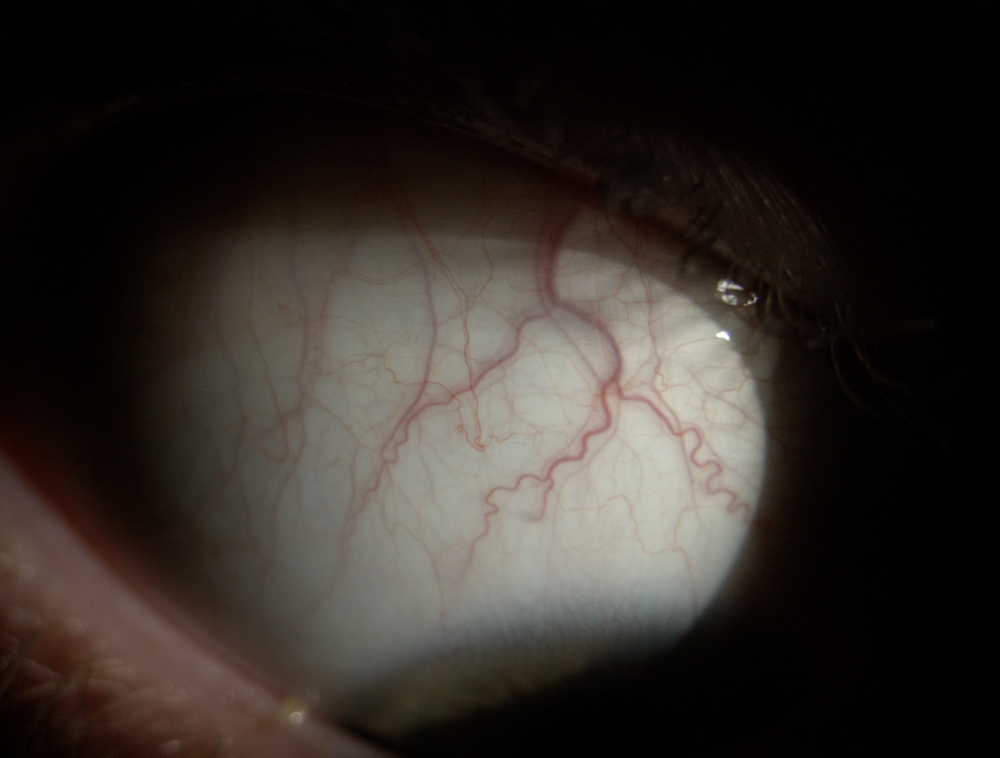

In [155]:
index = np.random.randint(len(bi))
bi[index]

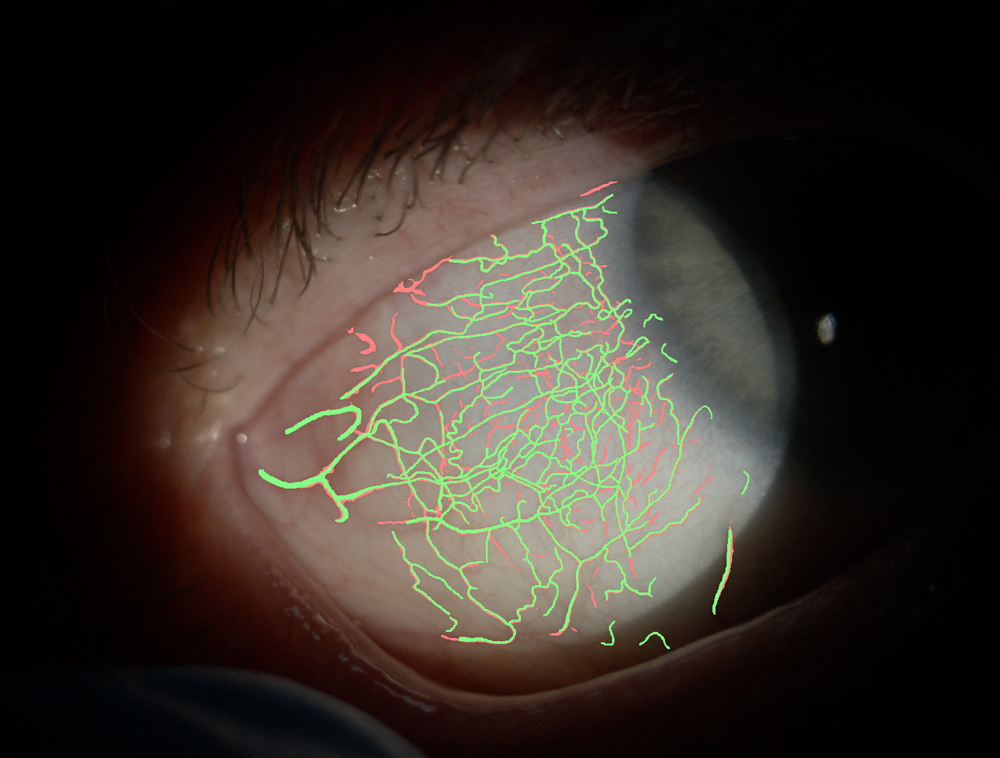

In [354]:
m1 = draw_mask(bi[index].convert('RGBA'), pred2[index], (255,0,0,124))
draw_mask(m1.convert('RGBA'), bm[index], (0,255,0, 124))

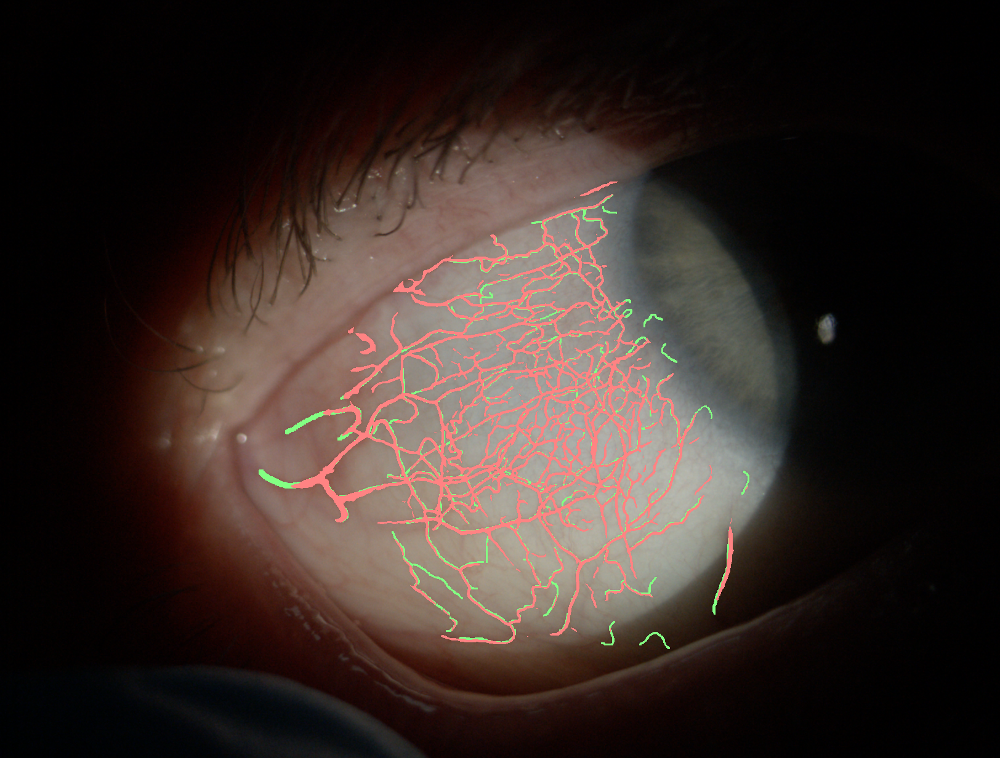

In [355]:
m1 = draw_mask(bi[index].convert('RGBA'), bm[index], (0,255,0, 124))
draw_mask(m1.convert('RGBA'), pred2[index], (255,0,0,124))

'776.png'

182.png


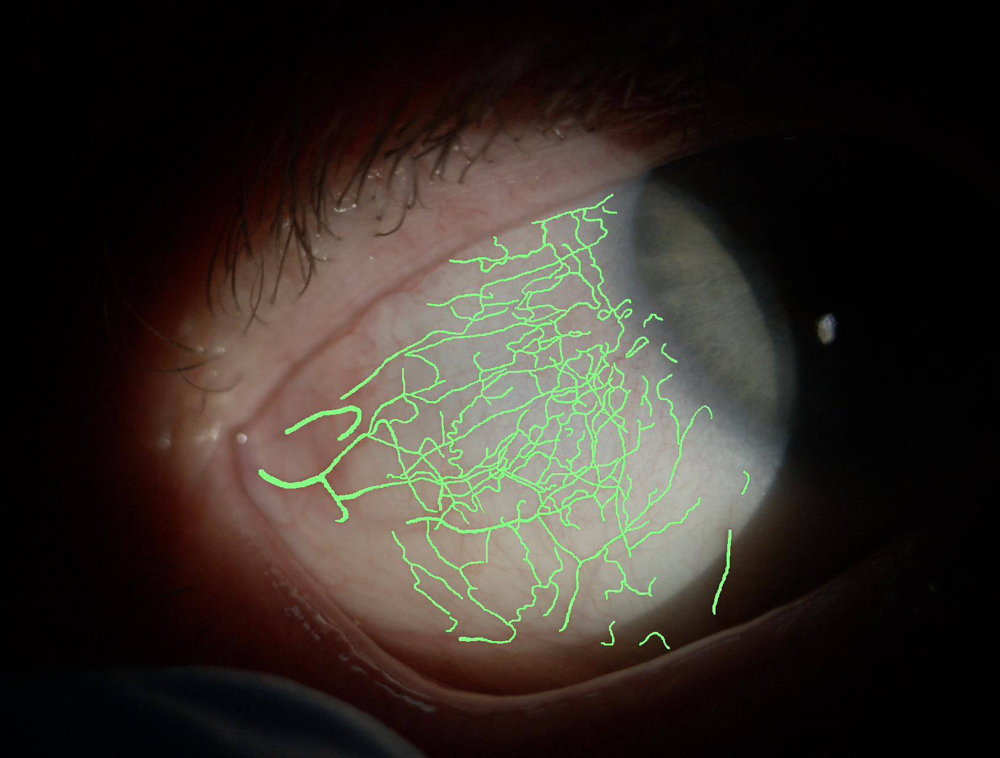

In [352]:
index = np.random.randint(len(bi))
print(bi.filenames[index])
draw_mask(bi[index].convert('RGBA'), bm[index], (0,255,0, 124))

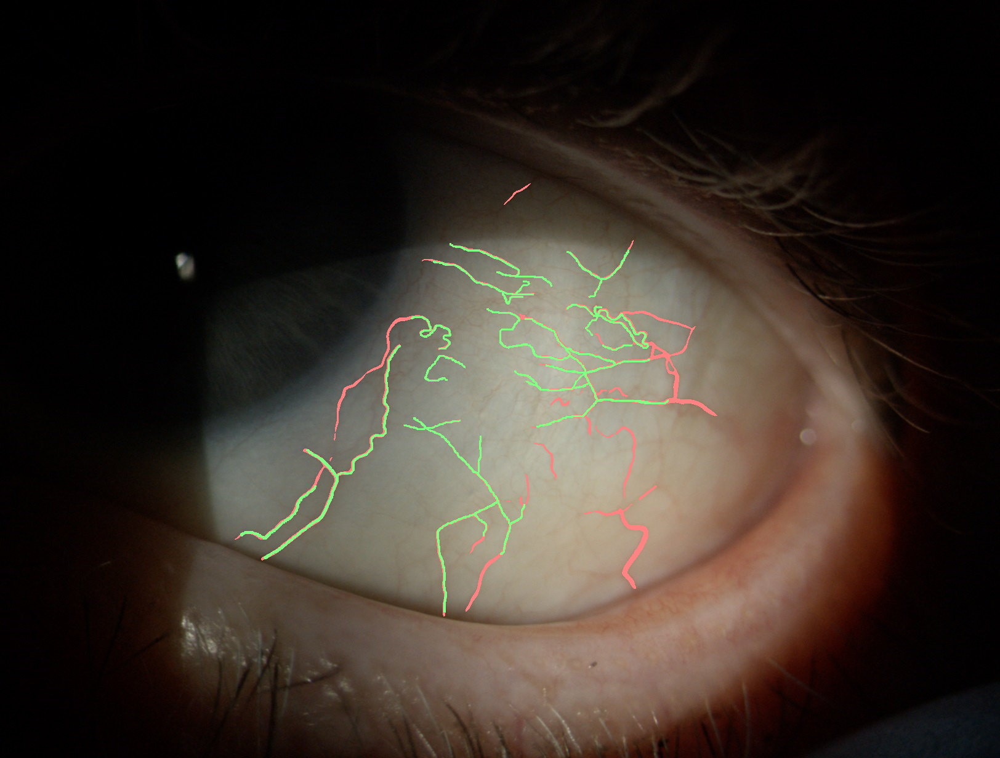

In [138]:
index = np.random.randint(len(bi))

m1 = draw_mask(bi[index].convert('RGBA'), pred1[index], (255,0,0,124))
draw_mask(m1.convert('RGBA'), bm[index], (0,255,0, 124))

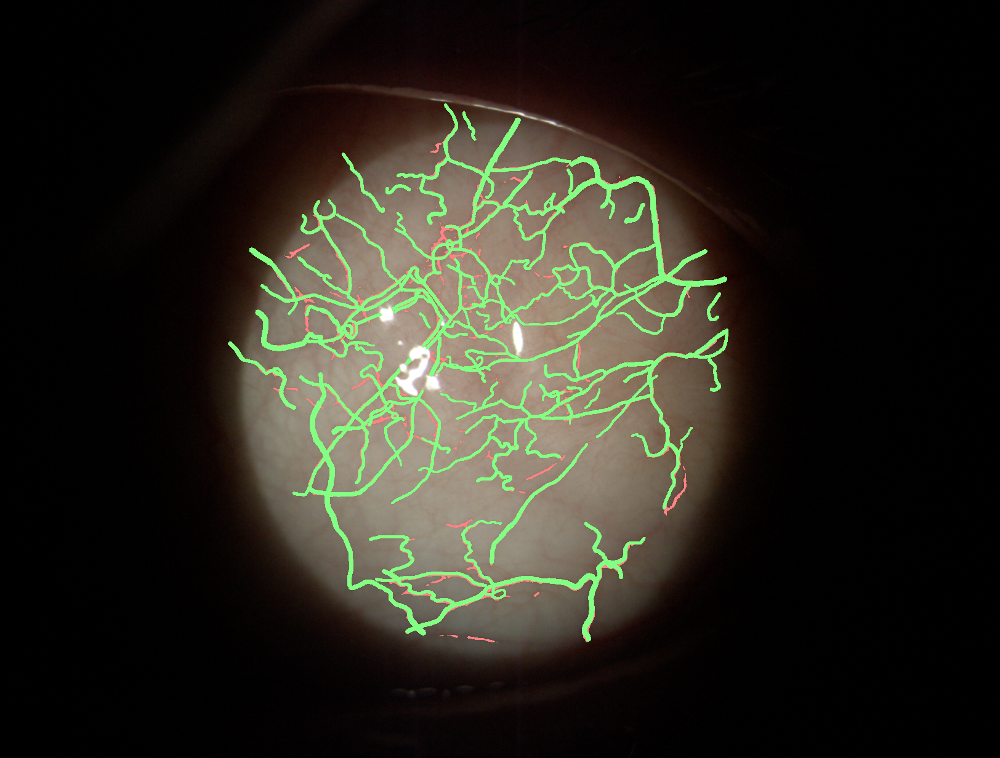

In [124]:

m1 = draw_mask(bi[index].convert('RGBA'), pred2[index], (255,0,0,124))
draw_mask(m1.convert('RGBA'), bm[index], (0,255,0, 124))

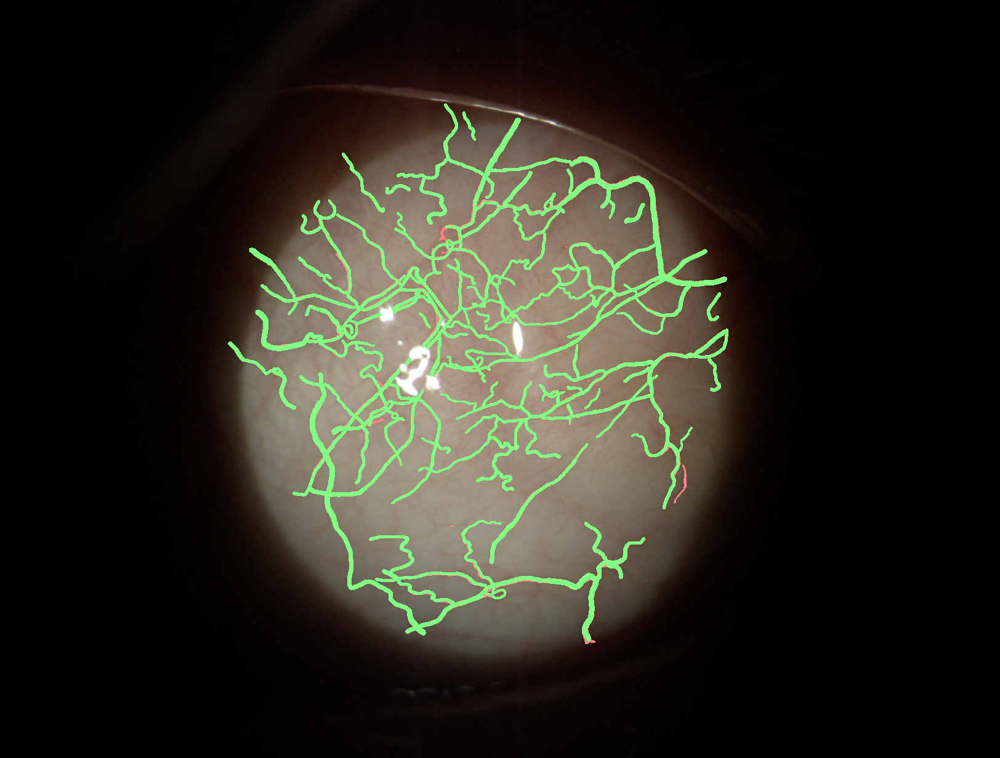

In [125]:

m1 = draw_mask(bi[index].convert('RGBA'), pred3[index], (255,0,0,124))
draw_mask(m1.convert('RGBA'), bm[index], (0,255,0, 124))

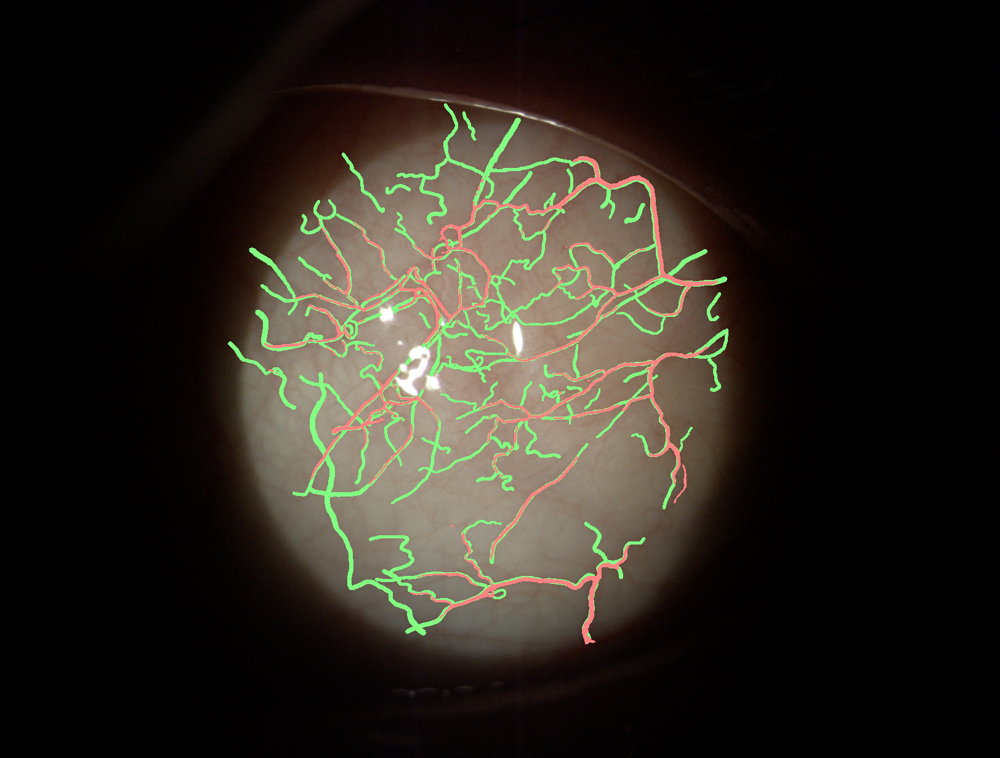

In [126]:

m1 = draw_mask(bi[index].convert('RGBA'), bm[index], (0,255,0, 124))
draw_mask(m1.convert('RGBA'), pred3[index], (255,0,0,124))

In [329]:
filenames = sorted(os.listdir('../datasets/infer/images'), key=lambda x: int(x.split('.')[0]))
test_images = BaseImage('../datasets/infer/images', filenames)

bi = BaseImage('../datasets/infer/images/', filenames)
total_best = get_prediction_explorer('wtf-submit-2.zip', filenames)
# exp1 = get_prediction_explorer('../experiments/unet/1-3-before-resnet18-1024-12-1e-05-300-0-last-clean-2-0-last-clean-2/20220930-121223-submit-temp.zip', filenames)
# exp2 = get_prediction_explorer('../experiments/unet/1-3-before-resnet18-1024-12-1e-05-300-0-last-clean-2-0-last-clean-2/20220930-132611-submit-temp.zip', filenames)

# exp1 = get_prediction_explorer('../experiments/unet/20220930-151353-resnet34-1024-1-0.0001-300-0-last-broken-0-last-broken/20220930-164140-submit-temp.zip', filenames)
# exp1 = get_prediction_explorer('../experiments/unet/20220930-151914-resnet34-1024-1-0.0001-300-2-filtered-mini-2-filtered-mini/20220930-154844-submit-temp.zip', filenames)
# exp2  = get_prediction_explorer('../experiments/unet/20220930-194709-resnet34-1024-4-0.0001-300-0-last-clean-small-0-last-clean-small/20220930-201652-submit-temp.zip', filenames)
# exp1  = get_prediction_explorer('../experiments/unet/20220930-202720-resnet34-1024-4-0.0001-300-0-last-clean-small-0-last-clean-small/20220930-203534-submit-temp.zip', filenames)
# exp1 = get_prediction_explorer('../experiments/unet/20220930-183813-resnet34-256-8-0.0001-300-0-last-clean-small-0-last-clean-small/20220930-204236-submit-temp.zip', filenames)
# exp2  = get_prediction_explorer('../experiments/unet/20220930-202720-resnet34-1024-4-0.0001-300-0-last-clean-small-0-last-clean-small/20220930-203907-submit-temp.zip', filenames)

# exp1 = get_prediction_explorer('../experiments/unet/20220930-212603-resnet34-1024-2-0.0001-300-4-whololooo-4-whololooo/20220930-221409-submit-temp.zip', filenames)
# exp2  = get_prediction_explorer('../experiments/unet/20220930-221710-resnet34-1024-2-0.0001-300-4-whololooo-4-whololooo/20220930-224035-submit-temp.zip', filenames)
# exp2  = get_prediction_explorer('../experiments/unet/20220930-205215-resnet34-1024-4-0.0001-300-1-basic-1-basic/20220930-225200-submit-temp.zip', filenames)
exp1 = get_prediction_explorer('../experiments/unet/20220930-231157-efficientnetb0-1024-2-0.001-300-4-whololooo-4-whololooo/20220930-232416-submit-temp.zip', filenames)

# exp1 = get_prediction_explorer('../experiments/unet/1-3-before-resnet18-1024-12-1e-05-300-0-last-clean-2-0-last-clean-2/20220930-121223-submit-temp.zip', filenames)
# exp2 = get_prediction_explorer('../experiments/unet/1-4-before-resnet18-1024-2-1e-05-300-0-last-clean-2-0-last-clean-2/20220930-141252-submit-temp.zip', filenames)
# exp3 = get_prediction_explorer('../experiments/unet/20220930-131202-resnet34-1024-1-1e-05-300-1-basic-1-basic/20220930-141932-submit-temp.zip', filenames)
# exp4 = get_prediction_explorer('../experiments/unet/20220930-134218-resnet34-1024-1-1e-05-300-1-basic-1-basic/20220930-141600-submit-temp.zip', filenames)

In [337]:
index = filenames.index('849.png')#np.random.randint(len(filenames))

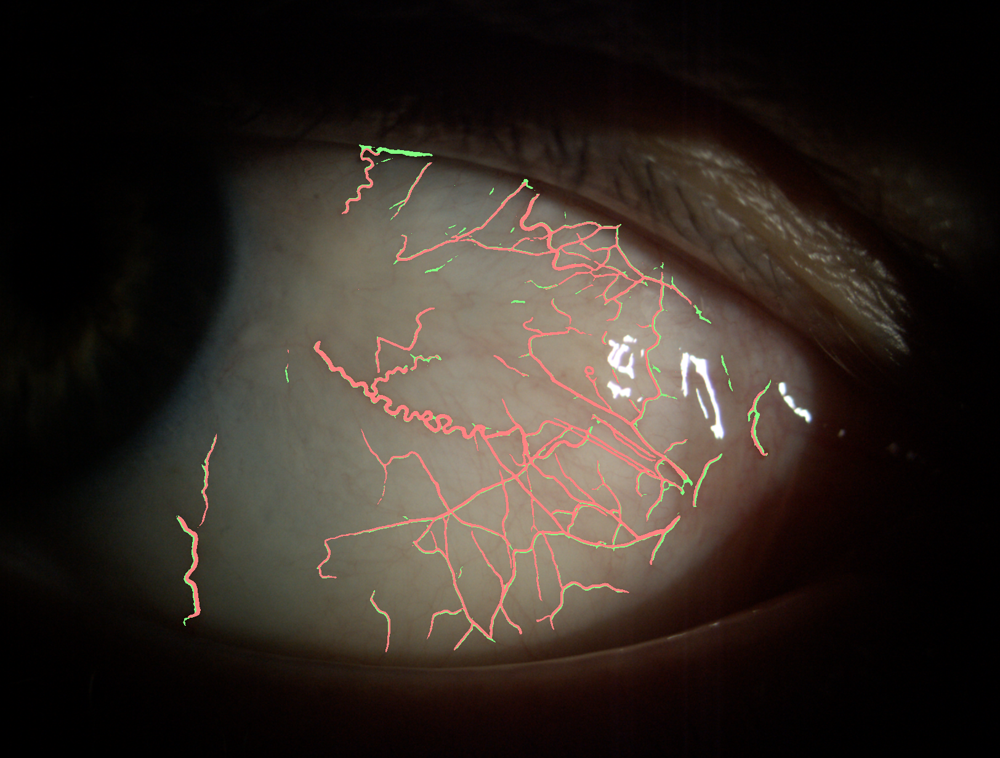

In [338]:
m1 = draw_mask(bi[index].convert('RGBA'), exp1[index], (0,255,0, 124))
draw_mask(m1.convert('RGBA'), total_best[index], (255,0,0, 124))

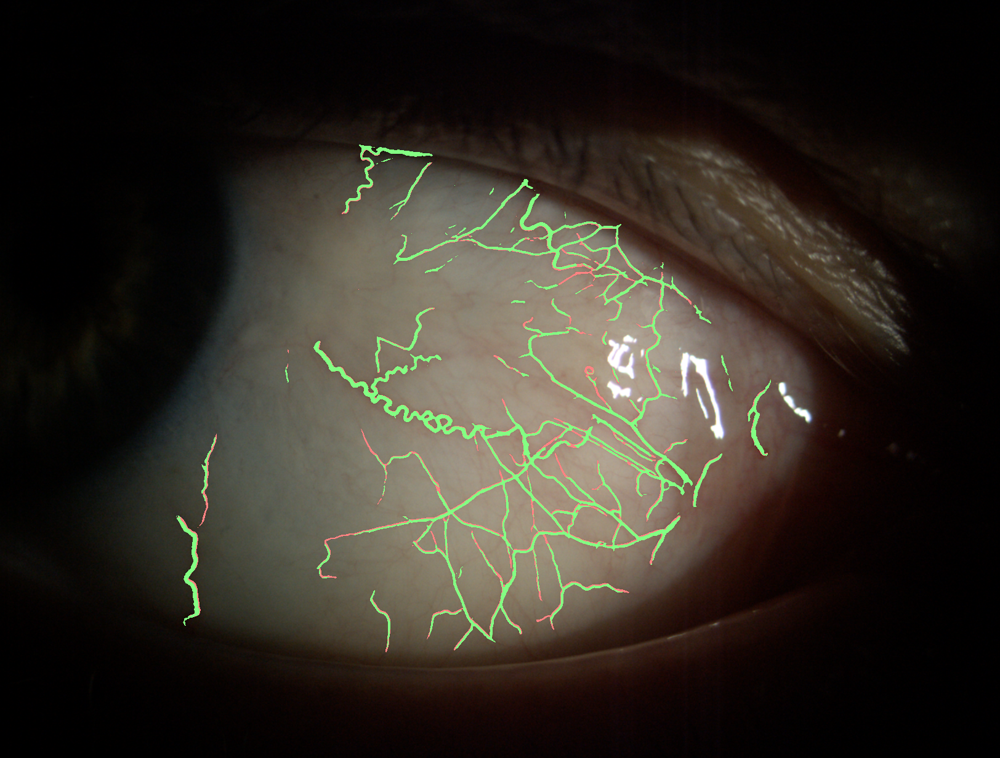

In [339]:
m1 = draw_mask(bi[index].convert('RGBA'), total_best[index], (255,0,0, 124))
# m1 = draw_mask(m1, exp2[index], (0,0,255,124))
draw_mask(m1.convert('RGBA'), exp1[index], (0,255,0, 124))

974.png


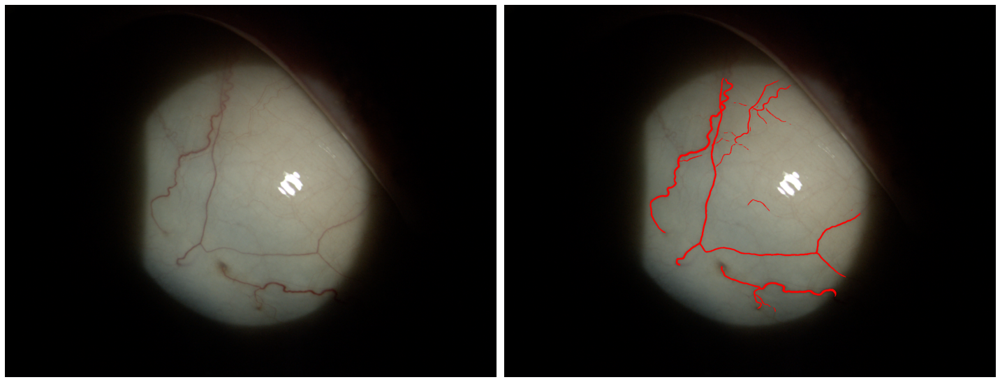

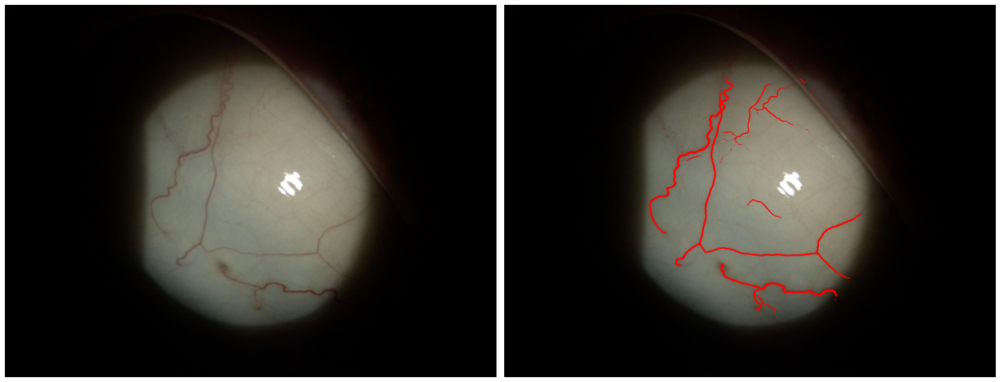

**************
846.png


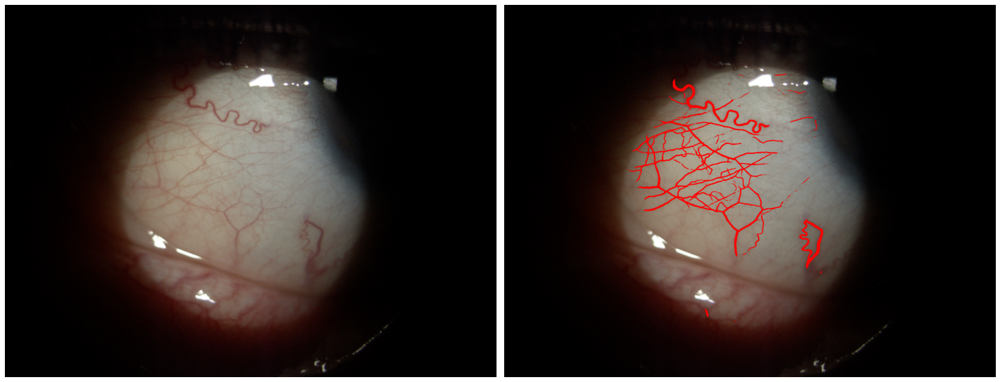

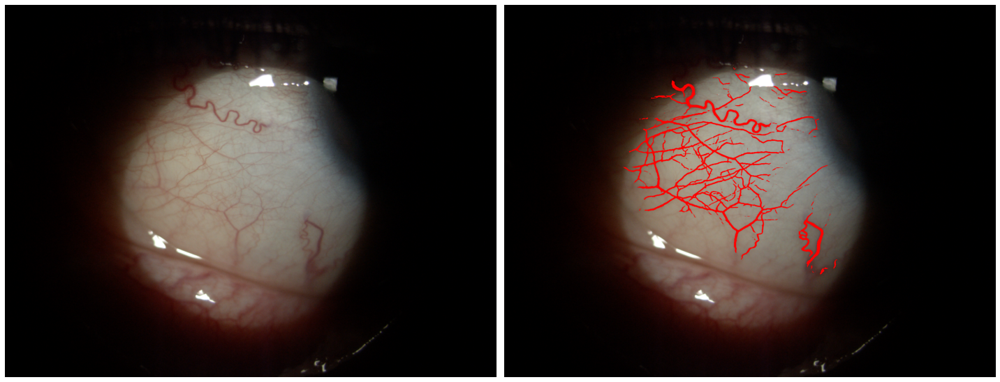

**************
857.png


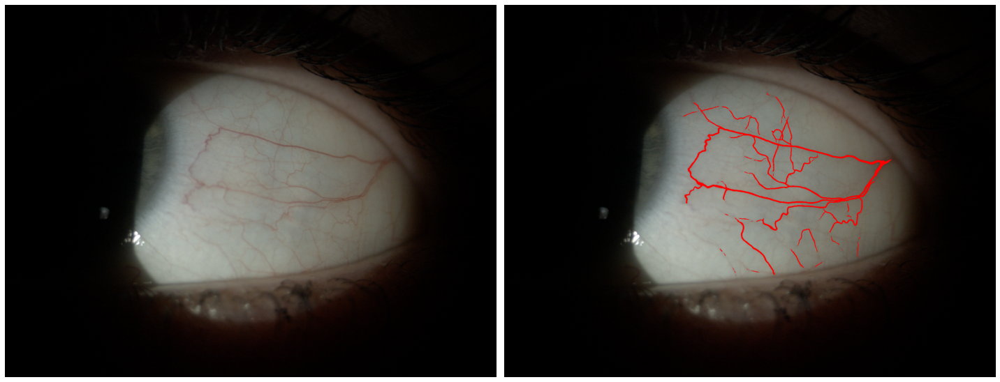

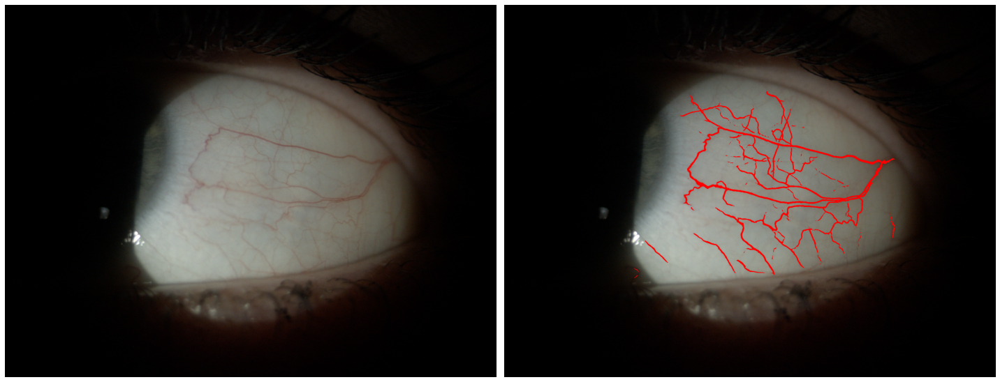

**************
876.png


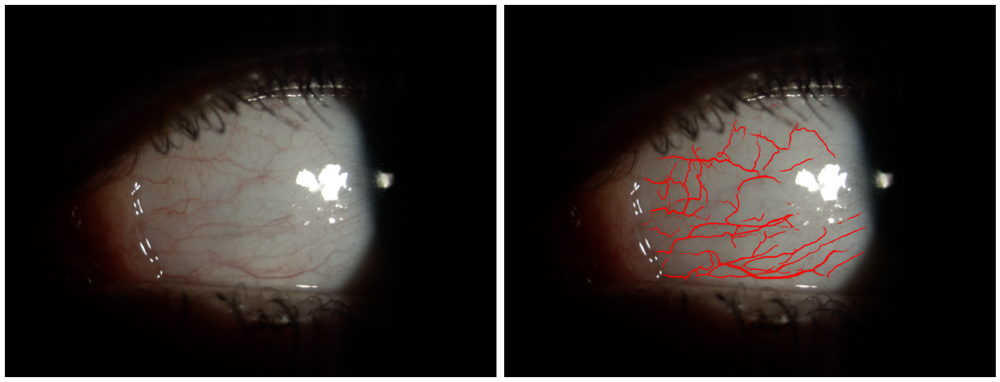

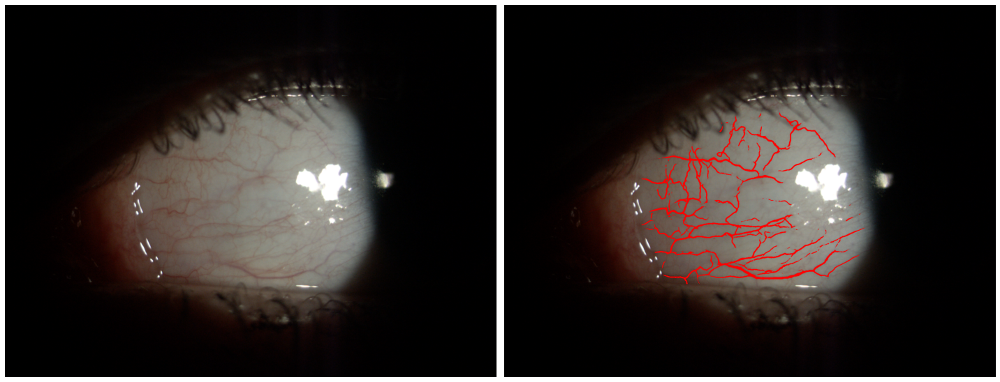

**************
831.png


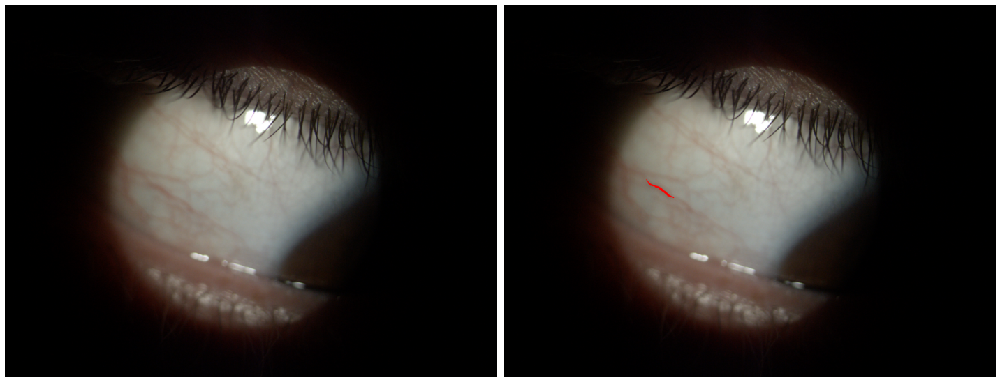

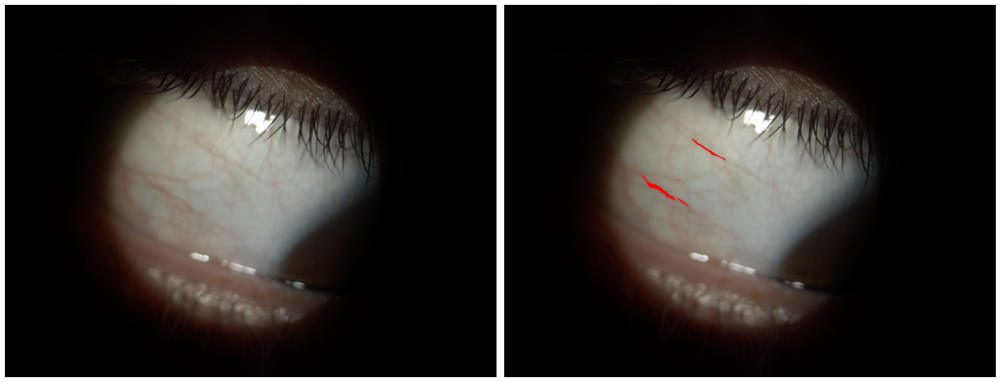

**************
1032.png


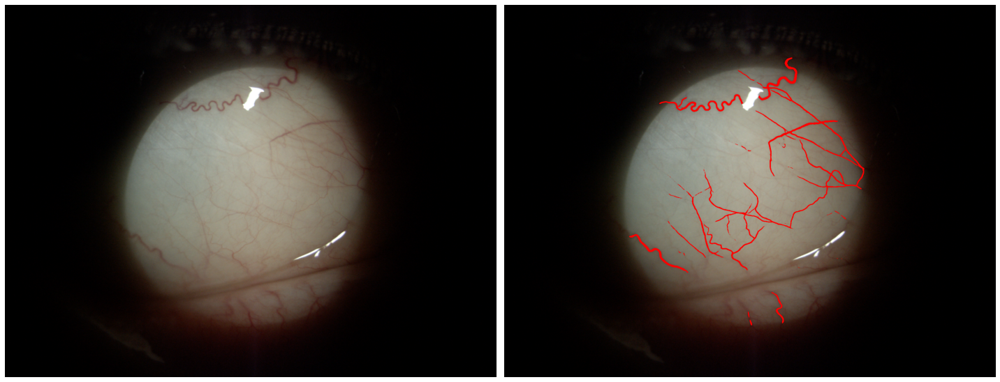

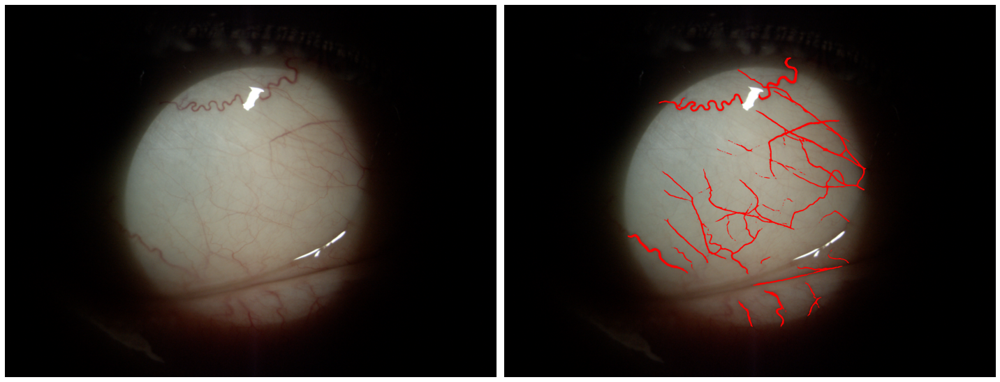

**************
1072.png


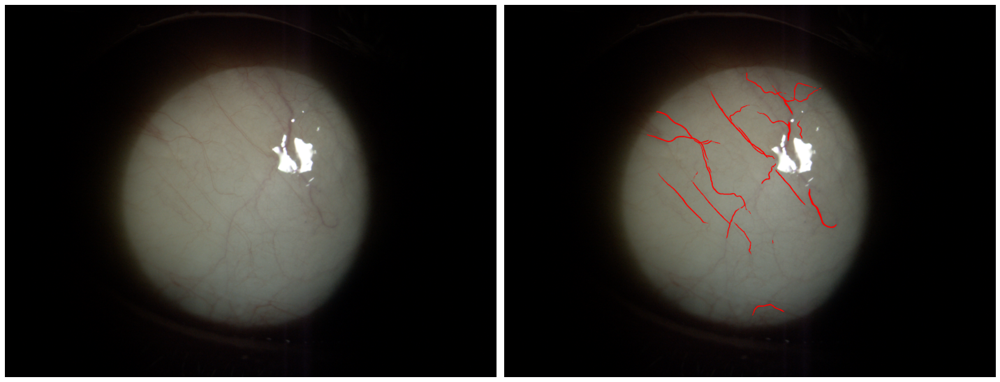

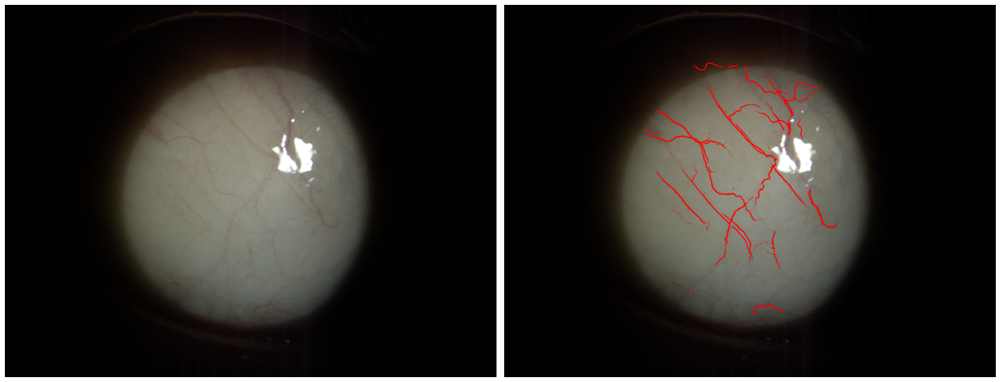

**************
1091.png


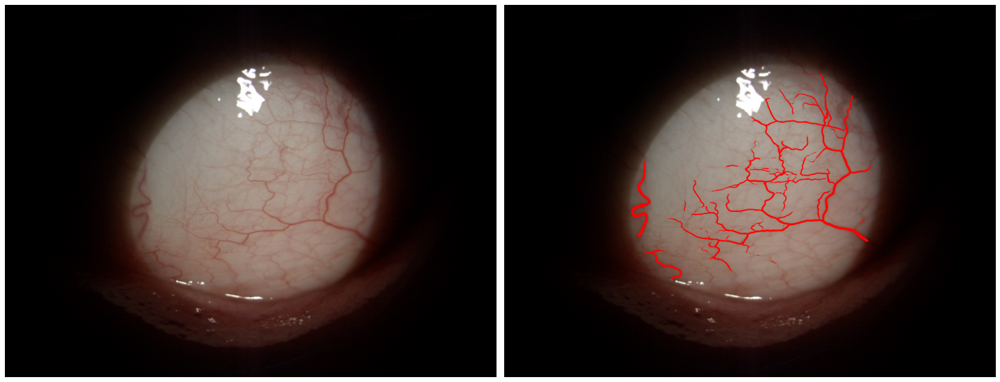

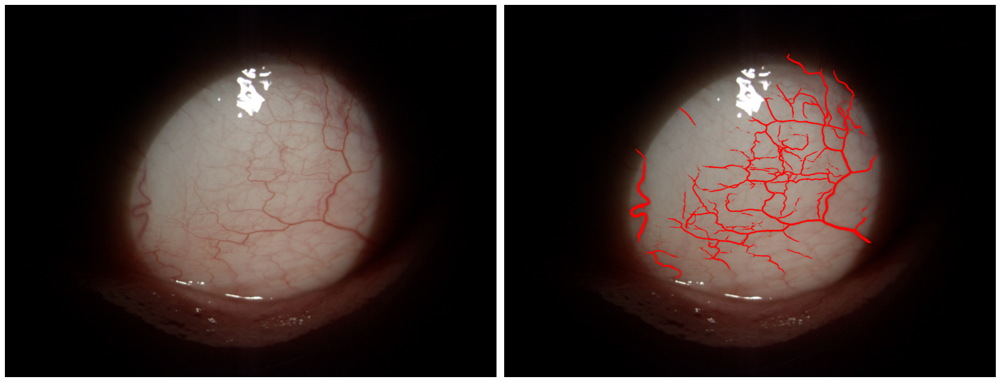

**************
1001.png


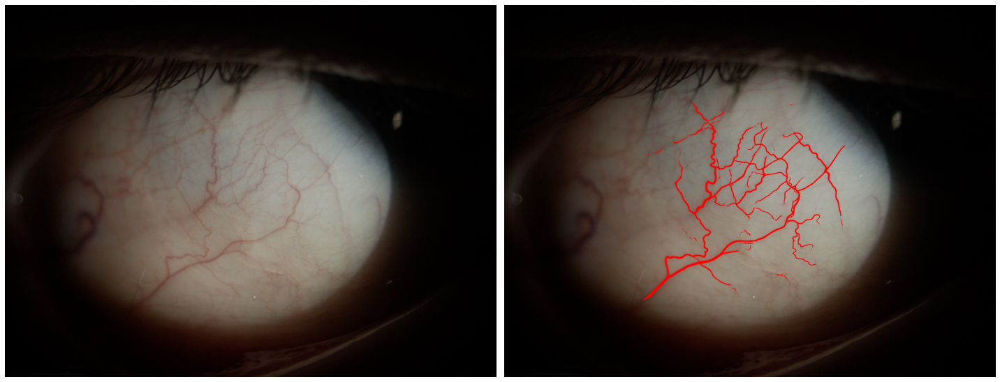

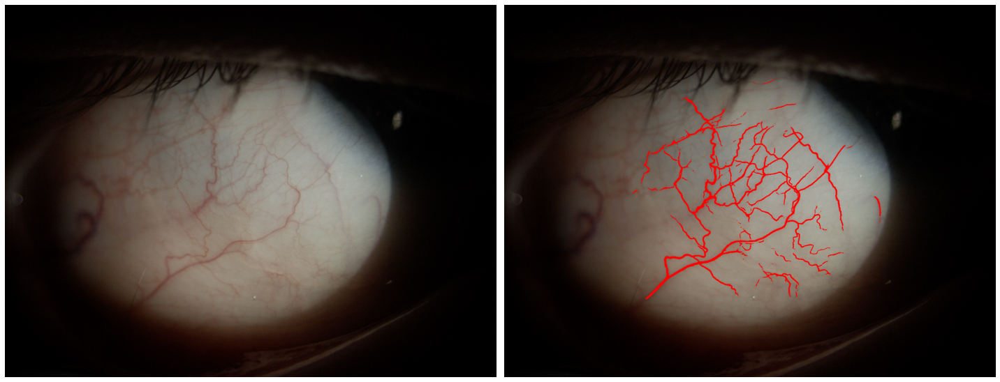

**************
817.png


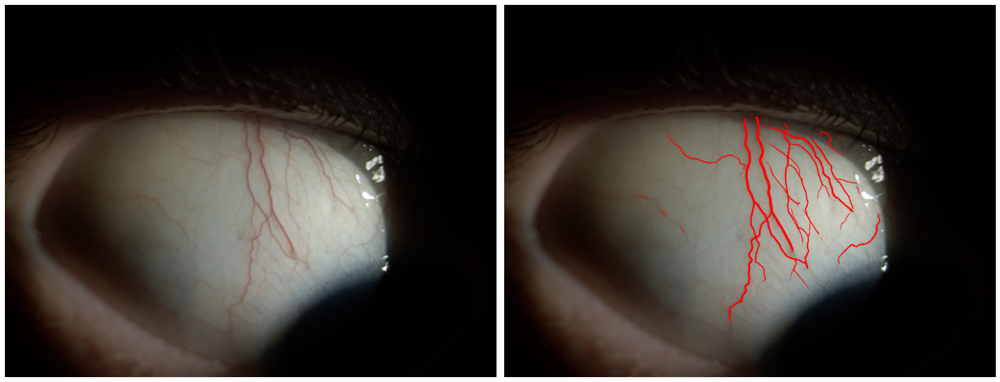

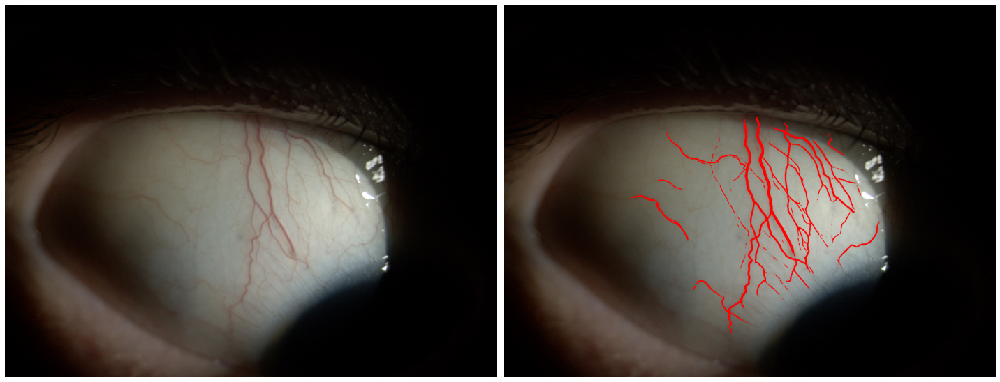

**************


In [18]:
indices = np.random.choice(np.arange(len(filenames)), size=10, replace=False)
for index in indices:
    print(filenames[index])
    plot_side_by_side(bi[index], draw_mask(bi[index],total_best[index]))
    plot_side_by_side(bi[index], draw_mask(bi[index],exp1[index]))
    print('**************')